# FEA Bending Modes

In [1]:
import numpy as np
import pandas as pd
import scipy.io

import matplotlib.pyplot as plt
import sys
sys.path.insert(0, '../')
from M1S_tools import *

plt.jet()

%matplotlib inline

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
## bending modes & influence matrices etc from Buddy #####################
ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991
## bending modes & influence matrices etc from Trupti #####################
N actuators =  170
/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents/influnce_matrix_files/OA_influence_matrices_all/OA_surface_normal_165SA_09Jan2025/
Afz =  (27547, 165)
Afx =  (27547, 165)
Afy =  (27547, 165)
U

<Figure size 640x480 with 0 Axes>

In [2]:
dataFolder = '/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents'
import glob

TRDate = '20Dec2024'
TRDate = '05Jan2025'
TRDate = '07Jan2025'
TRDate = '08Jan2025'
TRDate = '09Jan2025'

TRIFFolder = '/influnce_matrix_files/OA_influence_matrices_all/OA_surface_normal_*_%s/'%TRDate
TRIFFolder = glob.glob(dataFolder+TRIFFolder)[0]
print(TRIFFolder)
Dec24IFFolder = '/influnce_matrix_files/OA_influence_matrices_all/OA_surface_normal_normalised_20Dec2024/'
#read Afz (Fz influence matrix) - 01/02/2025. Trupti confirmed on slack that this is surface normal
df = pd.read_csv(TRIFFolder+'Afz-nohp-%s-%s-%s.csv'%(TRDate[:2],TRDate[2:5],TRDate[5:]), header=None)
Afz = np.array(df)
print('Afz = ',Afz.shape)
# this is Afz only; it is 28789 x 176. last 6 being HPs

#read Afx (Fx influence matrix)
df = pd.read_csv(TRIFFolder+'Afz-nohp-%s-%s-%s.csv'%(TRDate[:2],TRDate[2:5],TRDate[5:]), header=None)
Afx = np.array(df)
print('Afx = ', Afx.shape)

#read Afy (Fy influence matrix)
df = pd.read_csv(TRIFFolder+'Afz-nohp-%s-%s-%s.csv'%(TRDate[:2],TRDate[2:5],TRDate[5:]), header=None)
Afy = np.array(df)
print('Afy = ', Afy.shape)

/Users/bxin/Library/CloudStorage/OneDrive-SharedLibraries-GMTOCorp/M1S Portal - Documents/influnce_matrix_files/OA_influence_matrices_all/OA_surface_normal_165SA_09Jan2025/
Afz =  (27547, 165)
Afx =  (27547, 165)
Afy =  (27547, 165)


In [3]:
#read Fz Bending Modes & forces (note: Uzm is for the moments.)
df = pd.read_csv(TRIFFolder+'Uz_norm-nohp-%s-%s-%s.csv'%(TRDate[:2],TRDate[2:5],TRDate[5:]), header=None)
UMat = np.array(df)
print('U matrix', UMat.shape)

df = pd.read_csv(TRIFFolder+'Sz_norm-nohp-%s-%s-%s.csv'%(TRDate[:2],TRDate[2:5],TRDate[5:]), header=None)
SMat = np.array(df)
print('S matrix', SMat.shape)

df = pd.read_csv(TRIFFolder+'Vz_norm-nohp-%s-%s-%s.csv'%(TRDate[:2],TRDate[2:5],TRDate[5:]), header=None)
VMat = np.array(df)
print('V matrix', VMat.shape)

U matrix (27547, 165)
S matrix (165, 165)
V matrix (165, 165)


In [102]:
#this is what Trupti told me to do to normalize her VMat
VMat_normalized = np.linalg.pinv(SMat@VMat.T/VMat.shape[0])

In [103]:
#The above is simply doing this for each V vector
modeID=27
aa = 1/SMat[modeID-1, modeID-1] * VMat[:,modeID-1]

In [104]:
bb = np.linalg.pinv(SMat)[modeID-1, modeID-1] *VMat

In [105]:
cc = VMat @ np.linalg.pinv(SMat)

In [106]:
dd = np.linalg.inv(SMat)
dd[-3:,-3:] = 0
dd = VMat @ dd

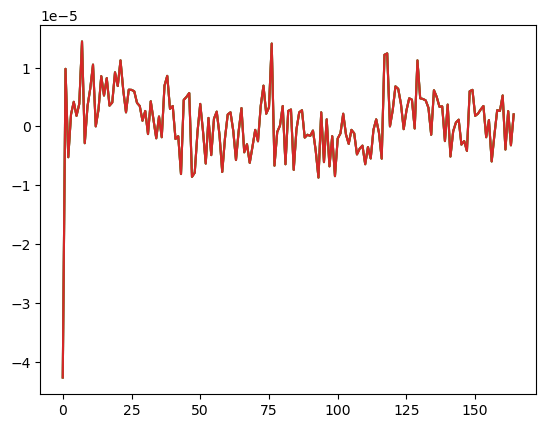

In [107]:
#this is the proof
#plt.plot(VMat_normalized[:,modeID-1])
plt.plot(VMat_normalized[:,modeID-1]-aa, label='aa')
plt.plot(VMat_normalized[:,modeID-1]-bb[:,modeID-1])
plt.plot(VMat_normalized[:,modeID-1]-cc[:,modeID-1],label='cc')
plt.plot(VMat_normalized[:,modeID-1]-dd[:,modeID-1],label='cc');

In [60]:
#read FEA nodes data
df = pd.read_csv(dataFolder+Dec24IFFolder+'surfacenodes_M1B-20-Dec-2024.csv')
nodeID = np.array(df['nodeID'])
nodex = np.array(df['X'])
nodey = np.array(df['Y'])
nodez = np.array(df['Z'])
print('N node = ', len(nodeID), len(nodex))

N node =  28789 28789


In [61]:
# use these indices to remove surface nodes outside of CA
noder = np.sqrt(nodex**2+nodey**2)
insideCA = noder< np.max(nodex_ml) #diameter_of_CA/2.0
nodeID = nodeID[insideCA]
nodex = nodex[insideCA]
nodey = nodey[insideCA]
nodez = nodez[insideCA]
#as of 1/8/25, TR already removed r>4.181m from Afz
#Afz = Afz[insideCA, :]

### Something wrong with Trupti's matrices

is she excluding nodes outside of CA?

she is still including HPs in SVD.

#### If we do our own SVD, we can reconstruct Afz without problem

In [62]:
#this takes ~1 minute
#U, S, Vt = np.linalg.svd(Afz[:,:nact]) #here we exclude the HPs, because our force RMS should not include those

#here we exclude the HPs, because our force RMS should not include those
#TR has done that.
#Afz = Afz[:,:nact] 
#Afz[:,-10:] *= 2 #Trupti divided them by 2, which she shouldn't have. Let's put the factor of 2 back
#U, S, Vt = np.linalg.svd(Afz[:,:(nact)], full_matrices=False) 
U, S, Vt = np.linalg.svd(Afz, full_matrices=False) 
print(U.shape, S.shape, Vt.shape)

(27547, 165) (165,) (165, 165)


### if we did 170 SAs instead of 165, would the BMs have been different?

In [144]:
Afz1=np.zeros((Afz.shape[0], 170))
Afz1[:,:165] = Afz[:,:165]
Afz1[:,165:170] = Afz[:,160:165] #duplicate the last 5 columns
U1, S1, Vt1 = np.linalg.svd(Afz1, full_matrices=False) 
print(U1.shape, S1.shape, Vt1.shape)

(27547, 170) (170,) (170, 170)


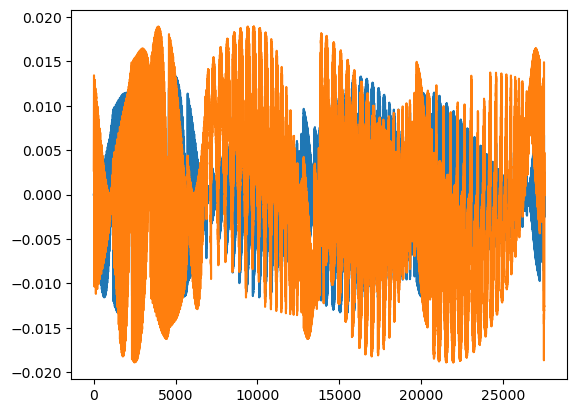

In [153]:
i = 5
plt.plot(U[:,i])
plt.plot(U[:,i]-U1[:,i])
#but below, you will see this is because the modes are rotated wrt each other.

(-4.599066915657406, 4.599069282899526, -4.5985067906447, 4.5984971614187105)

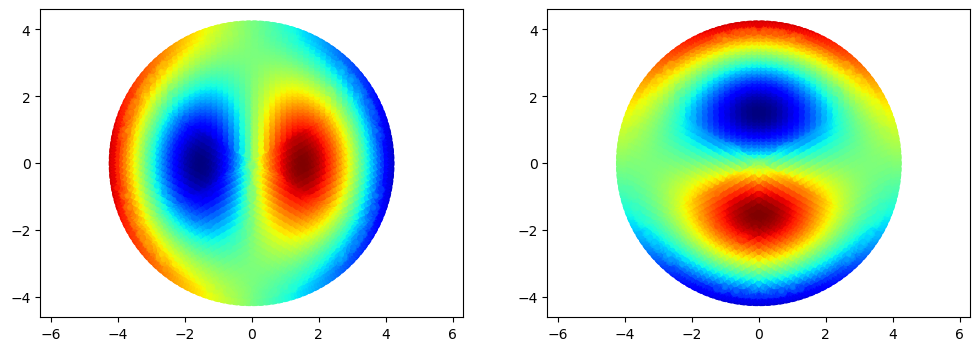

In [157]:
plt.figure(figsize=(12, 4))  # Adjust the figure size
plt.subplot(1, 2, 1) 
plt.scatter(nodex,nodey,10, U[:,5])
plt.axis('equal')
plt.subplot(1, 2, 2) 
plt.scatter(nodex,nodey,10, U1[:,5])
plt.axis('equal')

In [143]:
V1=Vt1.T
V=Vt.T
print(V1[-5:,0]/(V[-5:,0]/2))

[4.56120592 3.33099759 3.20458615 3.3103323  3.19653944]


In [88]:
print(np.max(U), np.max(S), np.max(Vt))
print(S[:5])

0.10660419522428309 2.3060655455140356e-06 0.3639568211139291
[2.30606555e-06 2.27899036e-06 8.56071755e-07 4.18007814e-07
 3.98621896e-07]


In [64]:
#reconstruct Afz using output matrices of above SVD
Sigma = np.zeros((Afz.shape[1], Afz.shape[1]))  # Create a matrix of zeros with the shape of A
#Sigma = np.zeros((Afz.shape[0], Afz.shape[1]-5))  # Create a matrix of zeros with the shape of A
np.fill_diagonal(Sigma, S)  # Place the singular values on the diagonal
bb = U @ Sigma @ Vt
print(bb[:3,:3])
print(Afz[:3,:3]) #this changed from prior to 1/9/25, because otherwise each Afz column would have PTT after excluding r>4.181m

[[2.00023068e-09 1.33224152e-09 6.88065924e-10]
 [1.96904454e-09 1.31459649e-09 6.75483248e-10]
 [1.92760307e-09 1.29058518e-09 6.58300012e-10]]
[[2.00023068e-09 1.33224152e-09 6.88065924e-10]
 [1.96904454e-09 1.31459649e-09 6.75483248e-10]
 [1.92760307e-09 1.29058518e-09 6.58300012e-10]]


## Next, we extract bending modes and their forces from our own SVD

In [66]:
U_TR = UMat.copy()
V_TR = VMat.copy()
S_TR = SMat.copy()
#VMat = VMat[:nact,:nact]
#VMat = VMat[:nact-5,:nact-5]

In [67]:
#Make UMat and VMat out of my SVD
UMat = U * np.sqrt(U.shape[0])
for modeID in range(1, Vt.shape[1]+1):
    VMat[:, modeID-1] = Vt.T[:, modeID-1] * 1e-6/S[modeID-1]*np.sqrt(UMat.shape[0])
    #1e-6 due to meter to micron conversion

In [68]:
#check BM force normalization
print("modeID; manually calculated RMS; RSS; numpy STD; numpy mean")
for i in np.arange(0,16):
    print('%3d, %8.1f, %8.1f, %8.1f, %+.2f'%(i+1, np.sqrt(np.sum(VMat[:,i]**2)/VMat.shape[0] ), 
                                         np.sqrt(np.sum(VMat[:,i]**2) ), 
          np.std(VMat[:,i]), np.mean(VMat[:,i])))

modeID; manually calculated RMS; RSS; numpy STD; numpy mean
  1,      5.6,     72.0,      5.6, +0.00
  2,      5.7,     72.8,      5.7, -0.00
  3,     15.1,    193.9,     15.1, -0.00
  4,     30.9,    397.1,     30.9, +0.00
  5,     32.4,    416.4,     32.4, +0.00
  6,     69.5,    892.9,     69.5, +0.00
  7,     72.1,    926.4,     72.1, -0.00
  8,     93.3,   1198.9,     93.3, -0.00
  9,     94.8,   1217.9,     94.8, -0.00
 10,    189.9,   2439.6,    189.9, +0.00
 11,    196.7,   2526.1,    196.7, -0.00
 12,    202.9,   2606.5,    202.9, +0.00
 13,    209.7,   2694.2,    209.7, +0.00
 14,    218.8,   2810.0,    218.8, +0.00
 15,    369.3,   4744.1,    369.3, +0.00
 16,    388.1,   4985.3,    388.1, -0.00


In [69]:
#check BM normalization
print("manually calculated RMS; numpy STD; numpy mean")
for i in np.arange(1,165,10):
    print('%.2f, %.2f, %+.2f'%(np.sqrt(np.sum(UMat[:,i]**2)/UMat.shape[0] ), 
          np.std(UMat[:,i]), np.mean(UMat_ml[:,i])))

manually calculated RMS; numpy STD; numpy mean
1.00, 1.00, -0.00
1.00, 1.00, -0.00
1.00, 1.00, -0.00
1.00, 1.00, -0.00
1.00, 1.00, -0.00
1.00, 1.00, -0.00
1.00, 1.00, -0.00
1.00, 1.00, +0.00
1.00, 1.00, -0.00
1.00, 1.00, +0.00
1.00, 1.00, -0.00
1.00, 1.00, -0.00
1.00, 1.00, +0.00
1.00, 1.00, -0.00
1.00, 1.00, +0.00
1.00, 1.00, -0.00
1.00, 1.00, -0.00


### How do they compare with TR's csv UMat and VMat

In [83]:
V_TR_normalized = np.linalg.pinv(S_TR@V_TR.T/165)*1e-6

(27547, 165) (27547, 165)
(165, 165) (165, 165)


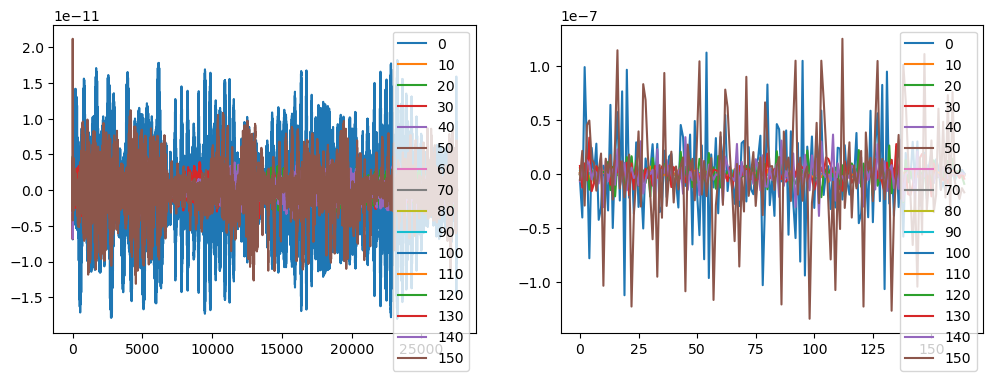

In [85]:
print(UMat.shape, U_TR.shape)
print(VMat.shape, V_TR.shape)
plt.figure(figsize=(12, 4))  # Adjust the figure size
plt.subplot(1, 2, 1) 
for i in range(0,160,10):
    plt.plot(UMat[:,i]-U_TR[:,i], label='%d'%i)
plt.legend()
plt.subplot(1,2,2)
for i in range(0,160,10):
    plt.plot(VMat[:,i]-V_TR_normalized[:,i], label='%d'%i)
plt.legend()

Looking at original data from Trupti

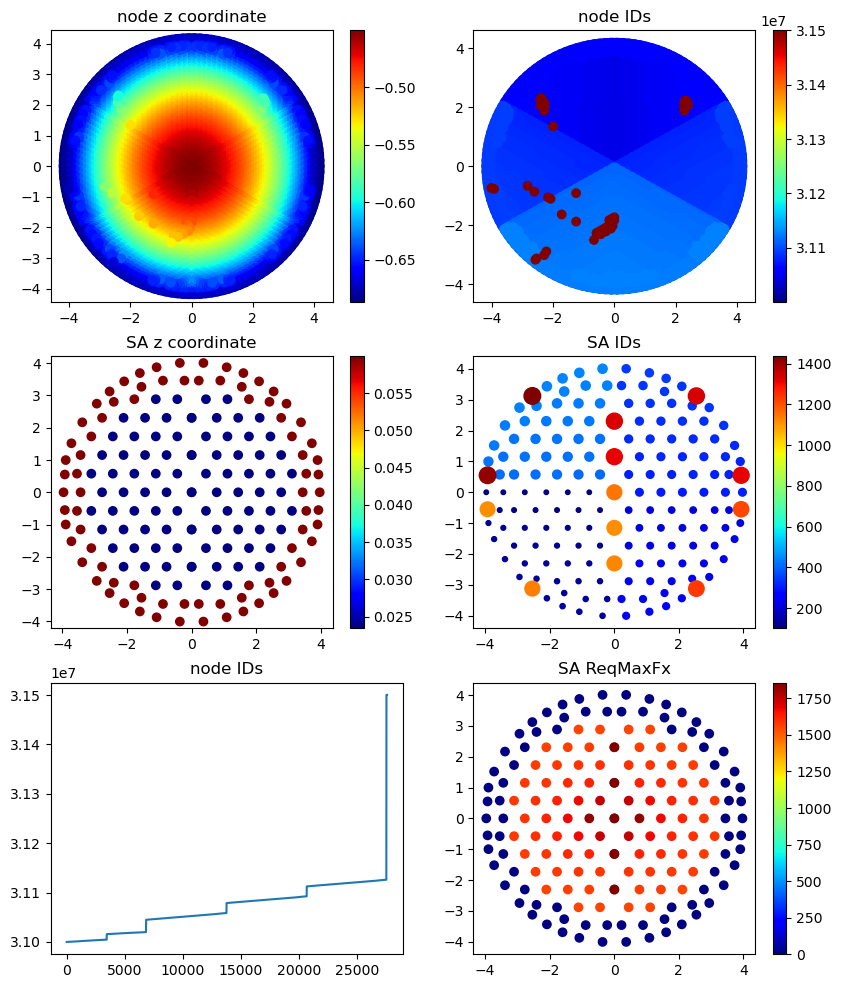

In [87]:
fig, ax = plt.subplots(3,2, figsize=(10,12))
img = ax[0][0].scatter(nodex, nodey, c=nodez)
fig.colorbar(img, ax=ax[0][0])
img = ax[0][1].scatter(nodex, nodey, c=nodeID)
fig.colorbar(img, ax=ax[0][1])
img = ax[1][1].scatter(sax, say, saID*0.1, c=saID)
fig.colorbar(img, ax=ax[1][1])
img = ax[1][0].scatter(sax, say, c=saz)
fig.colorbar(img, ax=ax[1][0])
img = ax[2][1].scatter(sax, say, c=saReqMaxFx_N)
fig.colorbar(img, ax=ax[2][1])
ax[2][0].plot(nodeID)
ax[0][0].set_title('node z coordinate')
ax[0][1].set_title('node IDs')
ax[1][0].set_title('SA z coordinate')
ax[1][1].set_title('SA IDs');
ax[2][0].set_title('node IDs')
ax[2][1].set_title('SA ReqMaxFx')
for i in range(3):
    for j in range(2):
        if not i==2 and j==0:
            ax[i][j].axis('equal')       

# In M1B, the 5 Quads are along y-axis !!! 

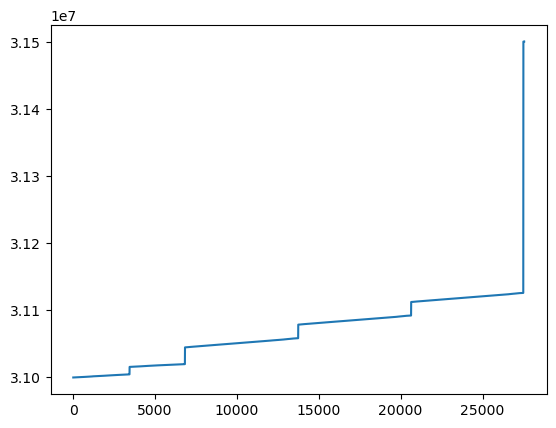

In [15]:
plt.plot(nodeID)

# Read in ML data so we can compare

In [16]:
dataFolder = '../model_data'

#read SA data
dfSA = scipy.io.loadmat(dataFolder+'/actCoords_ml.mat')
sax_ml = dfSA['yAct']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
say_ml = dfSA['xAct']/1e3 #turn into meter
print('ML actuators = ', len(sax_ml), len(say_ml))

#read Afz (Fz influence matrix)
df = scipy.io.loadmat(dataFolder+'/influenceFunctions_ml.mat')
Afn_ml = df['interactionMat']
fv_ml = df['forceMat'] #fv = fv^T
print('Afn = ',Afn_ml.shape)
print('fv = ', fv_ml.shape)
# this is Afz only; it is 6991 x 170.

#read Fz Bending Mode 
mat = scipy.io.loadmat(dataFolder+'/SVD_ml.mat')
UMat_ml = mat['U']
SMat_ml = mat['S']
VMat_ml = mat['V']
print('U matrix', UMat_ml.shape)

#read FEA nodes data
mat = scipy.io.loadmat(dataFolder+'/nodeCoords_ml.mat')
nodex_ml = mat['y']/1e3 #turn into meter #swap x/y to get to M1B (M1DCS uses M1B!!!)
nodey_ml = mat['x']/1e3 #turn into meter
print('N node = ', len(nodex_ml))

############normalize bending modes to RMS = 1um ###################
UMat_ml *= np.sqrt(UMat_ml.shape[0])
for modeID in range(1, UMat_ml.shape[1]+1):
    VMat_ml[:, modeID-1] *= 1e3/SMat_ml[modeID-1, modeID-1]*np.sqrt(UMat_ml.shape[0]) 
    #1e3 due to nanometer to micron conversion; RFCML mode shapes are in nanometers

ML actuators =  165 165
Afn =  (6991, 165)
fv =  (165, 165)
U matrix (6991, 165)
N node =  6991


Text(0.5, 1.0, 'Actuator IDs and locations in M1-B Coordinate System')

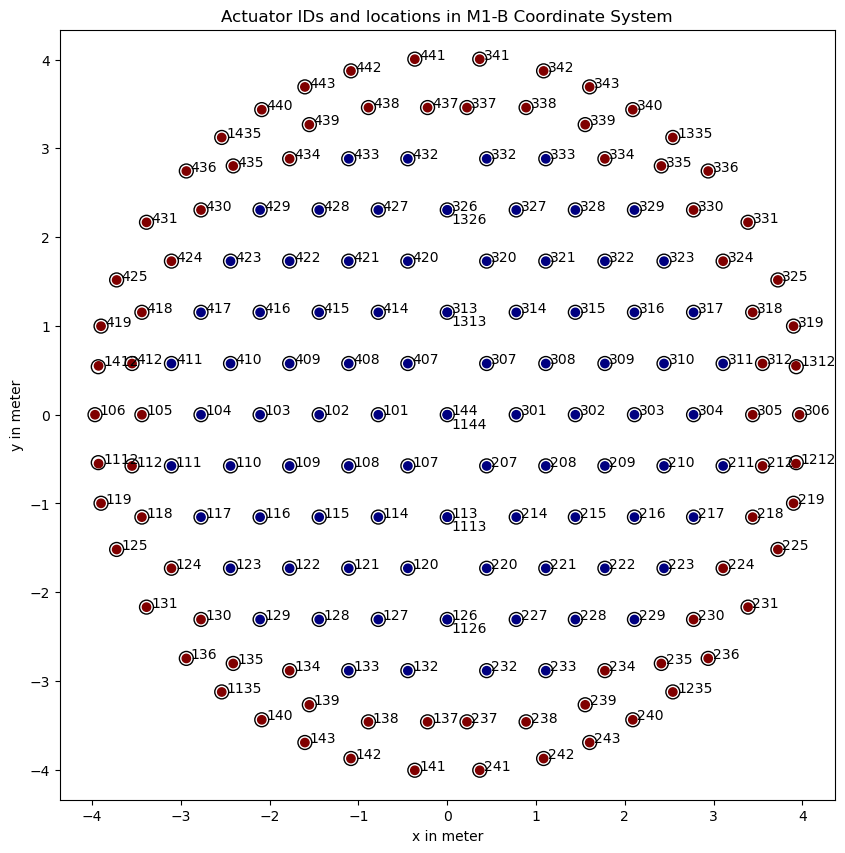

In [17]:
fig, ax = plt.subplots(1,1,figsize=(10,10))
plt.scatter(sax, say, c=saz)
plt.scatter(sax_ml, say_ml, s=100, facecolors='none', edgecolors='k')
for i in range(len(sax)):
    if (np.any(abs(sax[i]+say[i]-sax[:i]-say[:i])<1e-4)):
        plt.text(sax[i]+.05, say[i]-0.15, str(saID[i]))
    else:
        plt.text(sax[i]+.05, say[i], str(saID[i]))
plt.axis('equal')
plt.xlabel('x in meter')
plt.ylabel('y in meter')
plt.title('Actuator IDs and locations in M1-B Coordinate System')
#plt.grid()
#170 labels
#165 solid circles
#165 open circles

In [18]:
#only need to be executed when ID mapping has not been loaded.
saID_ml = np.zeros(len(sax_ml))
sa_offset = np.zeros(len(sax_ml))
for i in range(len(sax_ml)):
    offsetVec = np.hypot(sax_ml[i]-sax, say_ml[i]-say)
    found = np.where(offsetVec<0.1)[0] #less than 0.1meter
    #print(found)
    if len(found)==1:
        offset = offsetVec[found]
        saID_ml[i] = int(saID[found])
    else: #if found more than 1 GMT ID around the ML act.
        offset = offsetVec[found[0]]
        saID_ml[i] = saID[found[0]]*1e6+saID[found[1]]
    sa_offset[i] = offset
        #print()
    #else:
    #    print(i, saID[i],sax_ml[i], say_ml[i], found, offset)
    #    print(((abs(sax_ml[i]+say_ml[i]-sax-say)<0.1)))

In [19]:
#see figure above, 1112 is at between 8 o'clock and 9 o'clock
sax[saID==1112], sax_ml[saID_ml==1112]

(array([-3.92794]), array([[-3.93106656]]))

In [20]:
say[saID==1112], say_ml[saID_ml==1112]

(array([-0.551401]), array([[-0.54024505]]))

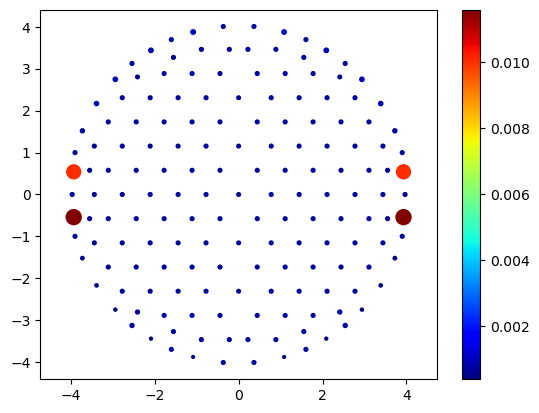

In [21]:
#show where the largest offsets are
plt.scatter(sax_ml, say_ml, .1e5*sa_offset, c=sa_offset)
plt.axis('equal')
plt.colorbar();

In [22]:
saID

array([ 101,  102,  103,  104,  105,  106,  107,  108,  109,  110,  111,
        112,  114,  115,  116,  117,  118,  119,  120,  121,  122,  123,
        124,  125,  127,  128,  129,  130,  131,  132,  133,  134,  135,
        136,  137,  138,  139,  140,  141,  142,  143,  207,  208,  209,
        210,  211,  212,  214,  215,  216,  217,  218,  219,  220,  221,
        222,  223,  224,  225,  227,  228,  229,  230,  231,  232,  233,
        234,  235,  236,  237,  238,  239,  240,  241,  242,  243,  301,
        302,  303,  304,  305,  306,  307,  308,  309,  310,  311,  312,
        314,  315,  316,  317,  318,  319,  320,  321,  322,  323,  324,
        325,  327,  328,  329,  330,  331,  332,  333,  334,  335,  336,
        337,  338,  339,  340,  341,  342,  343,  407,  408,  409,  410,
        411,  412,  414,  415,  416,  417,  418,  419,  420,  421,  422,
        423,  424,  425,  427,  428,  429,  430,  431,  432,  433,  434,
        435,  436,  437,  438,  439,  440,  441,  4

In [23]:
#print out saID_ml
for i in range(len(saID_ml)):
    print('%d'%saID_ml[i], end=' ')
    if i%10==9:
        print()

443 419 143 119 412 112 1435 1135 441 442 
440 436 431 439 425 106 141 142 140 136 
131 139 125 407 420 432 437 414 427 438 
421 433 415 428 422 434 416 429 435 423 
417 430 424 408 409 101 102 410 411 1412 
418 103 104 105 107 120 132 137 114 127 
138 121 133 115 128 122 134 116 129 135 
123 117 130 124 108 109 110 111 1112 118 
144001144 313001313 326001326 113001113 126001126 343 319 243 219 312 
212 1335 1235 341 342 340 336 331 339 325 
306 241 242 240 236 231 239 225 307 320 
332 337 314 327 338 321 333 315 328 322 
334 316 329 335 323 317 330 324 308 309 
301 302 310 311 1312 318 303 304 305 207 
220 232 237 214 227 238 221 233 215 228 
222 234 216 229 235 223 217 230 224 208 
209 210 211 1212 218 

In [24]:
#buddy did not give me act IDs. modeID just goes 1,2,3....,165
aa = np.zeros(171)
for modeID in range(1,171):
    aa[modeID-1] = saID2mlModeID(saID[modeID-1])
    print(aa[modeID-1], end= '  ')
print('\n max = %.0f '%np.max(aa))

46.0  47.0  52.0  53.0  54.0  16.0  55.0  75.0  76.0  77.0  78.0  6.0  59.0  64.0  68.0  72.0  80.0  4.0  56.0  62.0  66.0  71.0  74.0  23.0  60.0  65.0  69.0  73.0  21.0  57.0  63.0  67.0  70.0  20.0  58.0  61.0  22.0  19.0  17.0  18.0  3.0  140.0  160.0  161.0  162.0  163.0  91.0  144.0  149.0  153.0  157.0  165.0  89.0  141.0  147.0  151.0  156.0  159.0  108.0  145.0  150.0  154.0  158.0  106.0  142.0  148.0  152.0  155.0  105.0  143.0  146.0  107.0  104.0  102.0  103.0  88.0  131.0  132.0  137.0  138.0  139.0  101.0  109.0  129.0  130.0  133.0  134.0  90.0  113.0  118.0  122.0  126.0  136.0  87.0  110.0  116.0  120.0  125.0  128.0  100.0  114.0  119.0  123.0  127.0  98.0  111.0  117.0  121.0  124.0  97.0  112.0  115.0  99.0  96.0  94.0  95.0  86.0  24.0  44.0  45.0  48.0  49.0  5.0  28.0  33.0  37.0  41.0  51.0  2.0  25.0  31.0  35.0  40.0  43.0  15.0  29.0  34.0  38.0  42.0  13.0  26.0  32.0  36.0  39.0  12.0  27.0  30.0  14.0  11.0  9.0  10.0  1.0  79.0  8.0  164.0  93.0  135.0  

In [25]:
#only need to be executed when ID mapping has not been loaded.
#np.savetxt('saID_ml.txt', saID_ml)

In [91]:
U_TR.shape

(27547, 165)

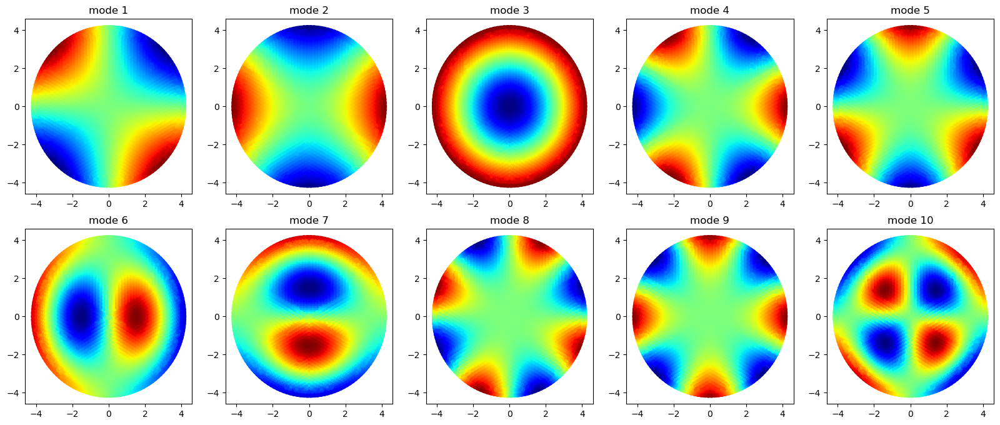

In [92]:
nrow = 2 #take ~2 minutes to run 15 rows
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(nodex, nodey,10, U_TR[:,modeID-1])
    ax[irow][icol].set_title('mode %d'%modeID)
#These are Trupti's modes

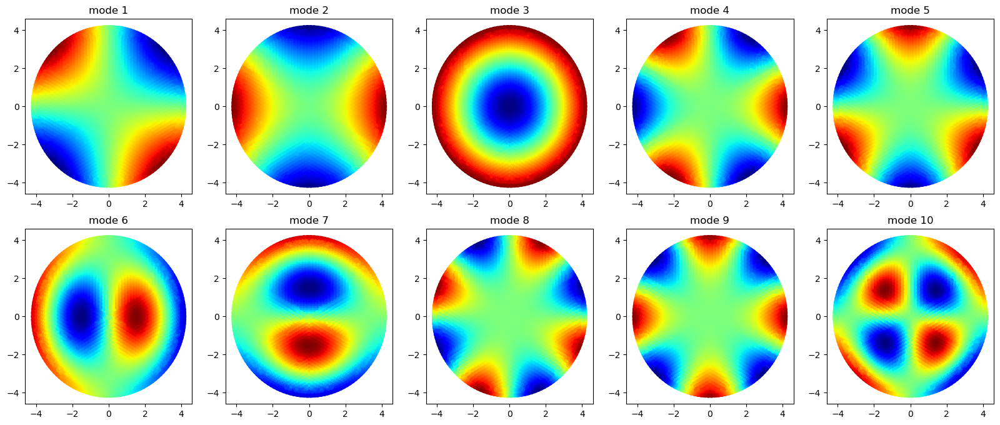

In [93]:
nrow = 2 #take ~2 minutes to run 15 rows
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d'%modeID)
#These are BX's modes

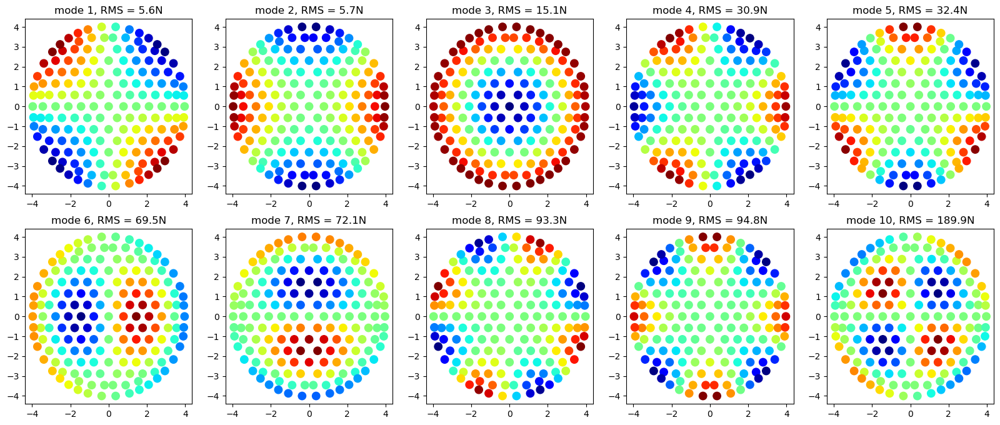

In [95]:
nrow = 2
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for modeID in range(1,5*nrow+1):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    i += 1

    img = ax[irow][icol].scatter(sax[:165], say[:165],80, VMat[:,modeID-1])
    ax[irow][icol].set_title('mode %d, RMS = %.1fN'%(modeID, np.std(VMat[:,modeID-1])))
#These are BX's modes

In [96]:
max(nodeID)

31500165

In [99]:
#double check gmtFvec2mlFvec() does not mess up the quad forces
print(np.sum(gmt165Fvec2mlFvec(VMat[:,i])), np.sum((VMat[:,i])))

-5.229594535194337e-12 -5.002220859751105e-12


# side by side comparison with ML bending modes

In [100]:
from scipy.interpolate import LinearNDInterpolator 
#we interpolate GMT BMs onto ML surface nodes to figure out any sign difference between the two sets of BMs

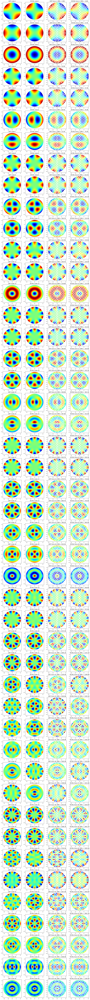

In [107]:
nrow = 46
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,nrow+1):
    sign_flip = 1
    interp = LinearNDInterpolator(list(zip(nodex, nodey)), UMat[:, modeID-1], fill_value=0)
    mapOntoML = interp(nodex_ml, nodey_ml).ravel()
    if np.std(mapOntoML+UMat_ml[:,modeID-1])<np.std(UMat_ml[:,modeID-1]):
        sign_flip = -1 #-1 means we need to flip
    #print(sign_flip)
    for j in range(4):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(nodex, nodey,10, UMat[:,modeID-1]*sign_flip)
            ax[irow][icol].set_title('GMT mode %d'%modeID)
        elif j==1:
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, UMat_ml[:,modeID-1])
            ax[irow][icol].set_title('RFCML mode %d'%modeID)    
        elif j==2:
            img = ax[irow][icol].scatter(sax[:165], say[:165],80, VMat[:,modeID-1]*sign_flip)
            ax[irow][icol].set_title('GMT Force %d, RMS = %.1fN'%(modeID, np.std(VMat[:,modeID-1])))
        elif j==3:
            #we convert ML force map to GMT acts, otherwise the quads visually differ by 2x.
            img = ax[irow][icol].scatter(sax[:165], say[:165],80, mlFvec2gmt165Fvec(VMat_ml[:,modeID-1]))
            ax[irow][icol].set_title('RFCML Force %d, RMS =  %.1fN'%(modeID, np.std(mlFvec2gmt165Fvec(VMat_ml[:,modeID-1]))))

In [108]:
VMat[:,modeID-1].shape, sax[:165].shape

((165,), (165,))

In [109]:
modeID = 1
print(np.sqrt(np.mean((UMat_ml[:,modeID-1])**2)))
print(np.sqrt(np.mean((UMat[:,modeID-1])**2)))
print(np.sqrt(np.mean((VMat_ml[:,modeID-1])**2)))
print(np.sqrt(np.mean((VMat[:,modeID-1])**2)))

0.9999999999999994
1.0000000000000007
6.619004334934111
5.603037579381402


In [110]:
#This takes 15 minutes to run
xtalk = np.zeros((46, 46))
for i in range(46):
    # method 1 (not good)
    # we pretend ML modes are real BMs. We use GMT BMs to run the tests, 
    # we characterize the xtalk by decomposing each GMT mode onto ML modes.
    # xtalk[i,j] is the ith coeff when jth ML mode is decomposed onto all GMT modes.
    #for BM#1, GMT says 5.6N RMS is needed to get 1um BM. ML says no, 6.6N. 
    #ML mode is stiffer. same force = less surf RMS bend. we want this to show up as xtalk[0,0]<1
    # PROBLEM: some modes diff by mostly a rotation angle. These show up as off-diagonal elements
    
    #interp = LinearNDInterpolator(list(zip(nodex, nodey)), UMat[:, i], fill_value=0)
    #mapOntoML = interp(nodex_ml, nodey_ml).ravel()
    #aa = UMat_ml.transpose() /UMat_ml.shape[0] @ mapOntoML
    #xtalk[:,i] = np.abs(aa[:46]) #sometimes the signs are reversed by ML and GMT
    
    #method 2
    # use ML influence matrix, multiple with GMT BM forces, get the mode shapes, decompose onto GMT BMs.
    #1e-3 due to nanometer to micron conversion; RFCML mode shapes are in nanometers
    ss_mlgrid = Afn_ml @ gmt165Fvec2mlFvec(VMat[:,i]) * 1e-3
    interp = LinearNDInterpolator(list(zip(np.squeeze(nodex_ml), np.squeeze(nodey_ml))), ss_mlgrid, fill_value=0)
    mapOntoGMT = interp(nodex, nodey).ravel()
    aa = UMat.transpose() / UMat.shape[0] @ mapOntoGMT
    xtalk[:, i] = aa[:46]

Text(0.05, 0.5, 'Force to Surface conversion \n via RFCML influence matrix')

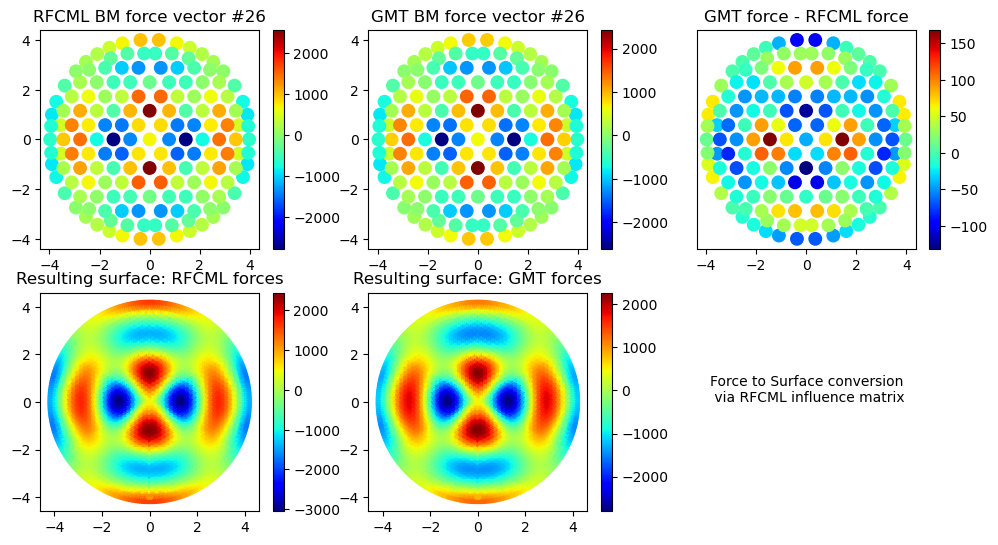

In [112]:
fig, ax = plt.subplots(2,3, figsize=(12,6.25))

modeID = 26
f1 = VMat_ml[:,modeID-1] #ML force for this bm
f2 = gmt165Fvec2mlFvec(VMat[:,modeID-1]) #GMT force for this bm, converted onto ML force vector format
img = ax[0][0].scatter(sax_ml, say_ml,80, f1)
fig.colorbar(img, ax=ax[0][0])
ax[0][0].set_title("RFCML BM force vector #%d"%modeID)

img = ax[0][1].scatter(sax_ml, say_ml,80, f2)
fig.colorbar(img, ax=ax[0][1])
ax[0][1].set_title('GMT BM force vector #%d'%modeID)

idx = np.abs(f1-f2)>-1
img = ax[0][2].scatter(sax_ml[~idx], say_ml[~idx],80, marker='o', facecolors='none', edgecolors='k')
img = ax[0][2].scatter(sax_ml[idx], say_ml[idx],80, f2[idx]-f1[idx])
fig.colorbar(img, ax=ax[0][2])
ax[0][2].set_yticks([])
#ax[0][2].set_title('Where force diff > 200N')
ax[0][2].set_title('GMT force - RFCML force')

img = ax[1][0].scatter(nodex_ml, nodey_ml, 10, Afn_ml @ f1)
fig.colorbar(img, ax=ax[1][0])
ax[1][0].set_title('Resulting surface: RFCML forces')
ax[1][1].set_title('Resulting surface: GMT forces')

img = ax[1][1].scatter(nodex_ml, nodey_ml, 10, Afn_ml @ f2)
fig.colorbar(img, ax=ax[1][1])
ax[1][2].axis('off')
ax[1][2].text(.05, .5, 'Force to Surface conversion \n via RFCML influence matrix')

In [113]:
np.max(nodex), np.max(nodex_ml), np.max(nodey_ml)

(4.18097218296512, 4.181, 4.187600000000001)

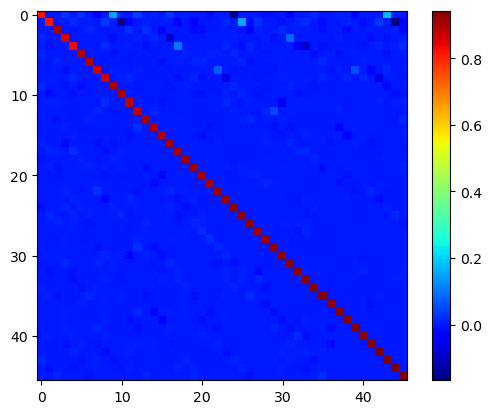

In [114]:
nx = 46
plt.imshow(xtalk[:nx,:nx])
plt.colorbar();

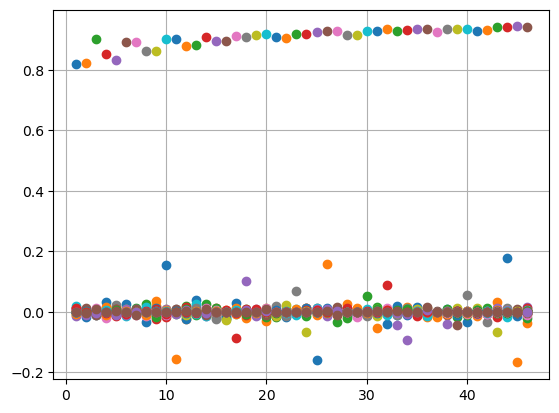

In [115]:
plt.plot(range(1,47),xtalk.transpose(),'o');
plt.grid();

## The BMs are the way they are. We next output BM forces for Sec 10 testing

In [40]:
df = pd.read_csv('../test_input_data/BM_amp_sec10.csv')
scaling = np.array(df['  S RMS(nm)'])/1000. #turn nm into micron

In [41]:
np.std(VMat[:,0])

5.520015235187456

In [42]:
array = np.zeros((nact,2))
array[:,0] = saID
for modeID in range(1,46+1):
    array[:,1] = scaling[modeID-1]*VMat[:,modeID-1]
    np.savetxt('../test_input_data/sec10_bm%02d_p.txt'%modeID, array,fmt = ('%d','%.8f'), delimiter=',',
               header='ALIAS,Z_FORCE')
    array[:,1] *= -1
    np.savetxt('../test_input_data/sec10_bm%02d_m.txt'%modeID, array,fmt = ('%d','%.8f'), delimiter=',',
               header='ALIAS,Z_FORCE')
    print('%2d, %5.0f, %5.0f'%(modeID, np.std(array[:,1]/npuck), np.max(array[:,1]/npuck)))

 1,     2,     5
 2,     2,     4
 3,     3,     8
 4,    10,    30
 5,     8,    24
 6,    15,    41
 7,    15,    43
 8,    28,    98
 9,    27,    93
10,    41,   104
11,    40,   109
12,    63,   205
13,    45,   183
14,    54,   197
15,    96,   317
16,    64,   177
17,   101,   234
18,    82,   206
19,    66,   225
20,    69,   193
21,   130,   426
22,   120,   464
23,   118,   217
24,   107,   305
25,   122,   421
26,    97,   240
27,    83,   186
28,   162,   443
29,   170,   505
30,   157,   425
31,   156,   442
32,   159,   441
33,   136,   308
34,   274,   823
35,   146,   437
36,   137,   343
37,   163,   440
38,   205,   522
39,   192,   461
40,   187,   542
41,   192,   601
42,   242,   898
43,   238,   916
44,   157,   515
45,   179,   461
46,   138,   312


## GMT single SA IF (influenceMat * [0 0 1 0 0 ... 0])

In [6]:
TR_IDs = np.loadtxt('SA_ID_for_IF.txt')

In [8]:
idx = np.zeros(nact)
for ii in range(nact):
    if saID[ii] in TR_IDs:
        if saz[ii]>0.04:
            idx[ii] = 1
        else:
            idx[ii] = 3

In [10]:
sax[idx!=0]

array([-1.77548, -2.93919,  1.77548,  2.93919,  1.77547,  2.93908,
       -1.77548, -2.93908,  0.     ,  0.     ,  0.     ,  0.     ,
        0.     ,  0.     ,  0.     ,  0.     ,  0.     ,  0.     ])

Text(0.5, 1.0, 'Actuator IDs and locations in M1-B Coordinate System')

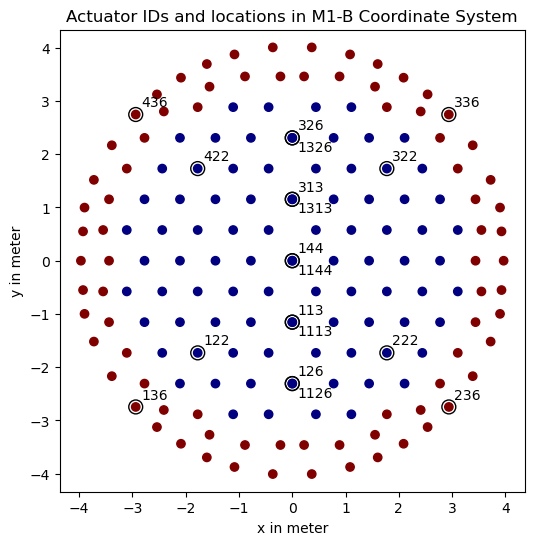

In [16]:
fig, ax = plt.subplots(1,1,figsize=(6,6))
plt.scatter(sax, say, c=saz)
plt.scatter(sax[idx!=0], say[idx!=0], s=100, facecolors='none', edgecolors='k')
for i in range(len(sax)):
    if idx[i] != 0:
        if (np.any(abs(sax[i]+say[i]-sax[:i]-say[:i])<1e-4)):
            plt.text(sax[i]+.1, say[i]-0.25, str(saID[i]))
        else:
            plt.text(sax[i]+.1, say[i]+0.15, str(saID[i]))
plt.axis('equal')
plt.xlabel('x in meter')
plt.ylabel('y in meter')
plt.title('Actuator IDs and locations in M1-B Coordinate System')

In [17]:
Afz.shape

(27685, 170)

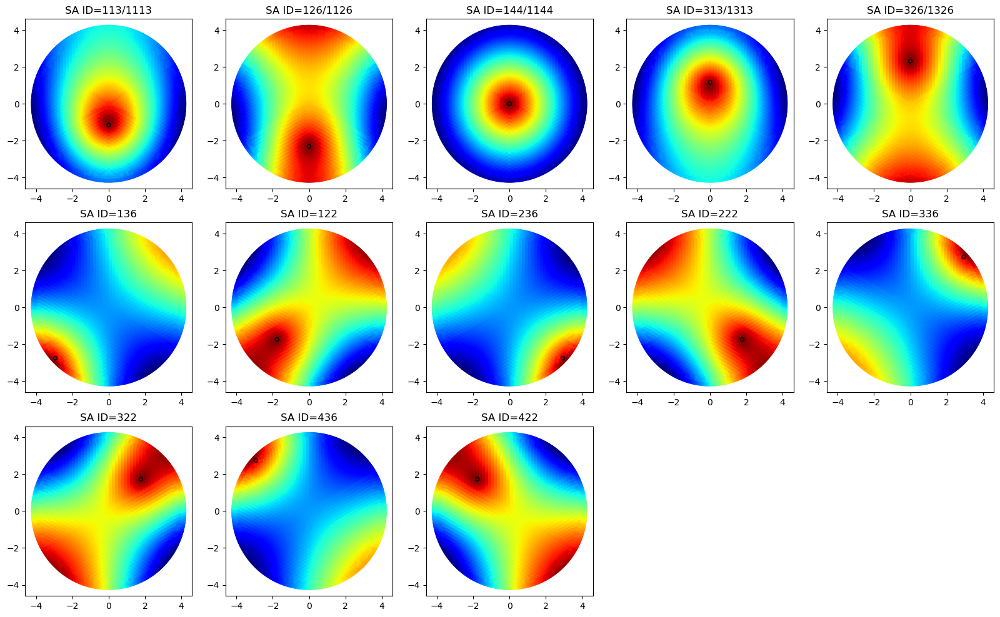

In [26]:
nrow = 3
fig, ax = plt.subplots(nrow,5,figsize=(20,4*nrow))
i = 0
for mysaID in TR_IDs:

    if mysaID < 1000:
        modeID = np.argmax(saID==mysaID)+1
        irow = np.int8(i/5)
        icol = np.mod(i,5)
        i += 1

        img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
        if mysaID in TR_IDs[:10]:
            ax[irow][icol].set_title('SA ID=%d/%d'%(saID[modeID-1], saID[modeID-1]+1000))
        else:
            ax[irow][icol].set_title('SA ID=%d'%(saID[modeID-1]))
        circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
        ax[irow][icol].add_artist(circle)
endMode = i
for i in range(endMode, nrow*5):
    irow = np.int8(i/5)
    icol = np.mod(i,5)
    ax[irow][icol].axis('off')

In [22]:
i

13

## Side by side comparison with ML single SA IF

In [28]:
IF_ml = Afn_ml @ fv_ml

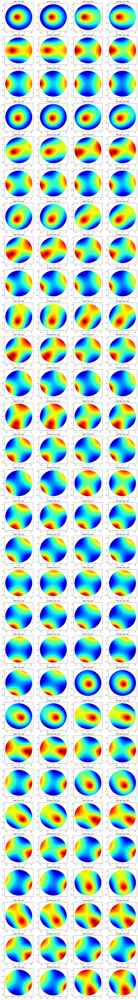

In [29]:
nrow = 30
fig, ax = plt.subplots(nrow,4,figsize=(16,4*nrow))
i = 0
for modeID in range(1,2*nrow+1):
    for j in range(2):
        irow = np.int8(i/4)
        icol = np.mod(i,4)
        i += 1
        
        if j==0:
            img = ax[irow][icol].scatter(nodex, nodey,10, Afz[:,modeID-1])
            ax[irow][icol].set_title('GMT SA %d'%saID[modeID-1])
            circle = plt.Circle((sax[modeID-1], say[modeID-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)
        else:
            modeID_ml = saID2mlModeID(saID[modeID-1]) #we want modeID_ml to start from 1 as well
            img = ax[irow][icol].scatter(nodex_ml, nodey_ml,10, IF_ml[:,modeID_ml-1])
            ax[irow][icol].set_title('RFCML SA %d'%saID_ml[modeID_ml-1])   
            circle = plt.Circle((sax_ml[modeID_ml-1], say_ml[modeID_ml-1]),0.1, fill=False)
            ax[irow][icol].add_artist(circle)